In [11]:
import cv2
import numpy as np
from pathlib import Path
import yaml
from PIL import Image
from hfnet.datasets.aachen import Aachen
from hfnet.evaluation.localization import Localization
from hfnet.evaluation.utils.db_management import read_query_list
from hfnet.evaluation.loaders import export_loader,export_loader_db
from hfnet.settings import DATA_PATH,EXPER_PATH

from notebooks.utils import plot_matches
from notebooks.utils import plot_keypoints
import operator
from functools import reduce
from pyquaternion import Quaternion

In [12]:
config_global = {
    'db_name': 'globaldb_netvlad.pkl',
    'experiment': 'netvlad/aachen',
    'predictor': export_loader, 
    'has_keypoints': False, 
    'has_descriptors': False, 
    'pca_dim': 4096,
    'num_prior': 10,
}
config_local = {
        'db_name': 'localdb_hfnet.pkl',
        'experiment':  'hfnet/aachen',
        'predictor_db': export_loader_db,
        'predictor': export_loader,
        'has_keypoints': True,
        'has_descriptors': True,
        # 'do_nms': True,
        # 'nms_thresh': 4,
        'num_features': 2000,
        'ratio_thresh': 0.9,
    }
# config_local = {
#     'db_name': 'localdb_superpoint.pkl',
#     'experiment': 'superpoint/aachen',
#     'predictor': export_loader,
#     'has_keypoints': True,
#     'has_descriptors': True,
# #    'do_nms': True,
# #    'nms_thresh': 4,
#     'num_features': 2000,
#     'ratio_thresh': 0.9,
# }
# config_local = {
#     'db_name': 'localdb_sift.pkl',
#     'colmap_db': 'cam03.db',
#     'ratio_thresh': 0.7,
#     'root': False,
#     'fast_matching': False,
# }
# model = 'cam03_model'
model = 'cam03_BA'

[01/19/2021 17:31:55 INFO] Importing COLMAP model cam03_model
/home/autolab/anaconda3/envs/cyf/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/autolab/anaconda3/envs/cyf/lib/python3.6/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
[01/19/2021 17:32:02 INFO] Number of images: 7303
Number of points: 293536
Median keypoints per image: 1817.0
Ratio of matched keypoints: 0.148

[01/19/2021 17:32:02 INFO] Importing global and local databases
[01/19/2021 17:32:05 INFO] Indexing descriptors


this is fastmatcher
this is fastmatcher
this is fastmatcher
this is fastmatcher
524 Failure, inliers  5  , ratio 0.010, landmarks    6, spl -1, places [2, 2, 2, 1, 1, 1, 1], pos ['-74.4', '95.6', '-3.5']
QUERT IMAGE---query/1606405726.20872613.png


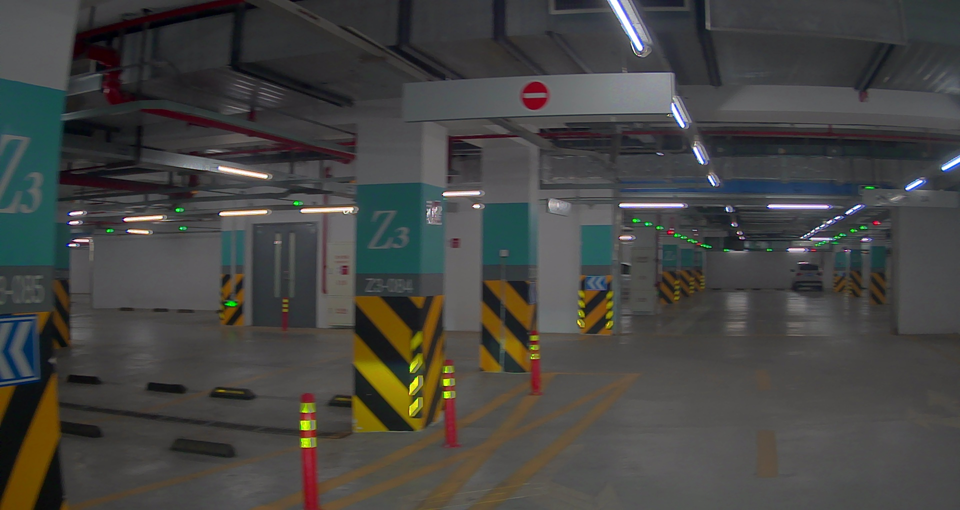

TOP K 
[6473, 6474, 6480, 6477, 6467, 6468, 6481, 6478, 6475, 6469]
['1606404851.50735493.png', '1606404851.60552350.png', '1606404852.20808371.png', '1606404851.97005064.png', '1606404850.90697809.png', '1606404851.00648074.png', '1606404852.30673935.png', '1606404852.06464422.png', '1606404851.70639300.png', '1606404851.10762760.png']


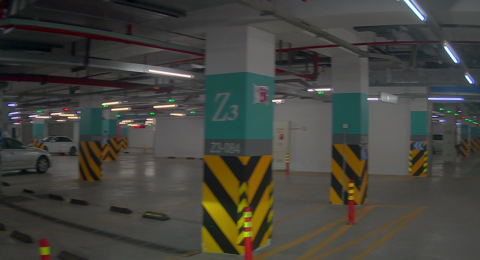

1606404851.50735493.png


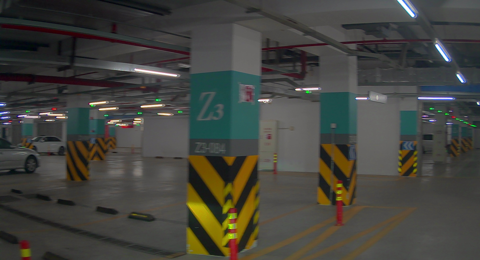

1606404851.60552350.png


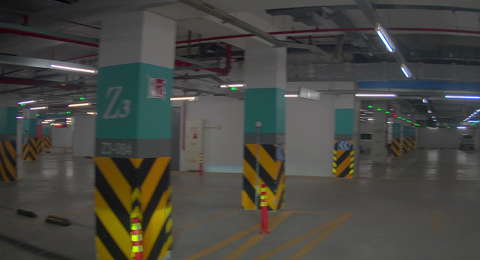

1606404852.20808371.png


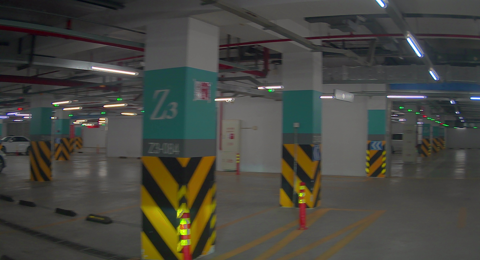

1606404851.97005064.png


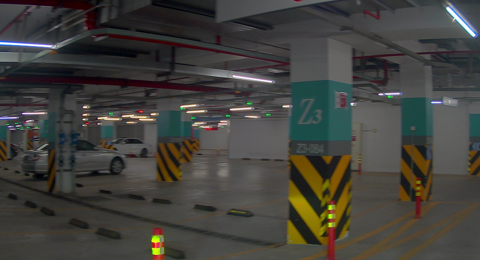

1606404850.90697809.png


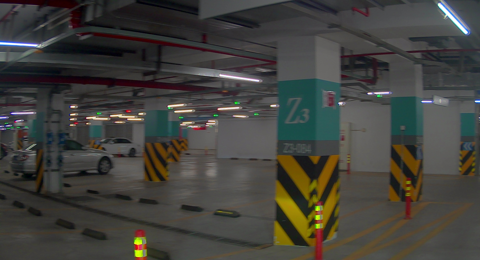

1606404851.00648074.png


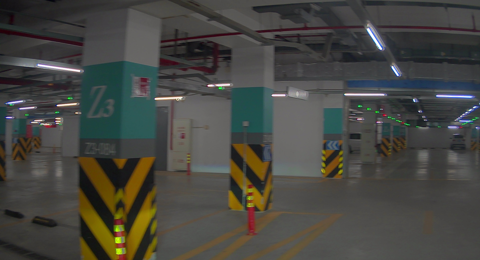

1606404852.30673935.png


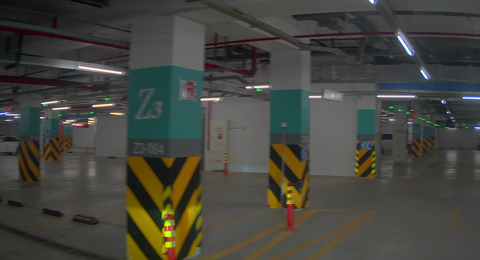

1606404852.06464422.png


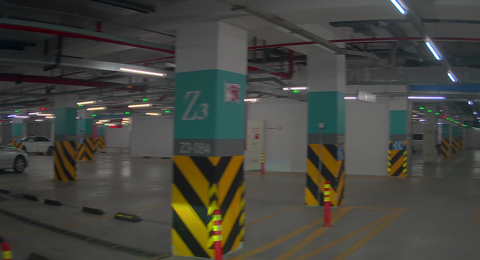

1606404851.70639300.png


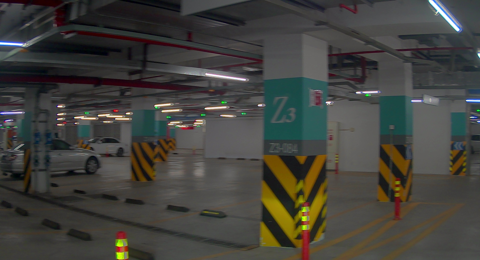

1606404851.10762760.png
FINAL_IMAGE:1606404851.60552350.png


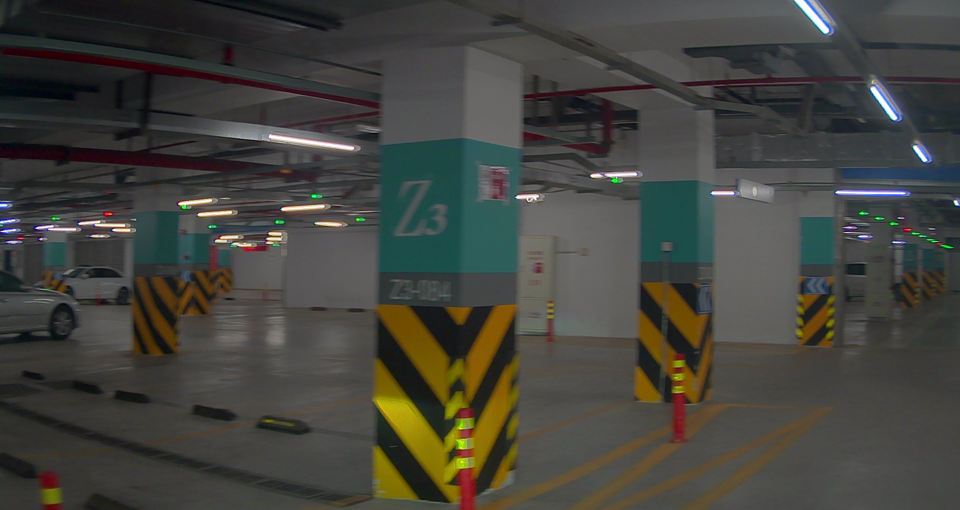

inliers:5
outliers:323
328
[0.2055666812446732, 0.20572995123782076, -0.6743721463416403, 0.6787044533258227] [-8.591517311281208, -2.827570712919537, 120.79646506588247]


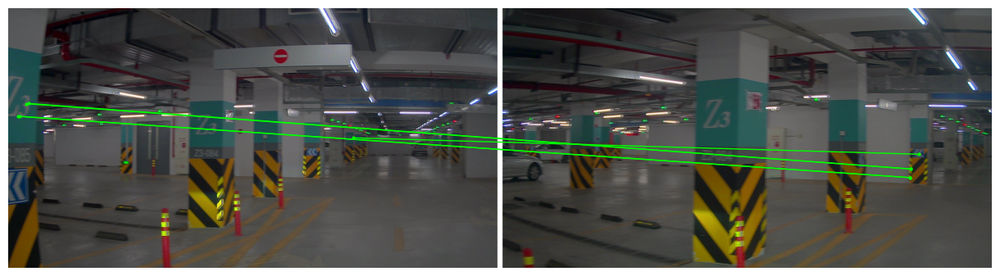

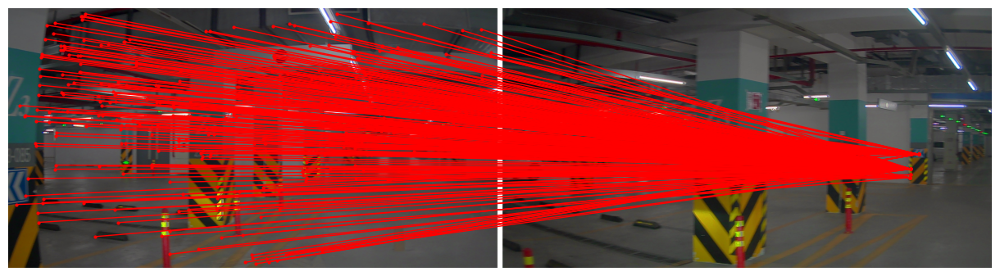

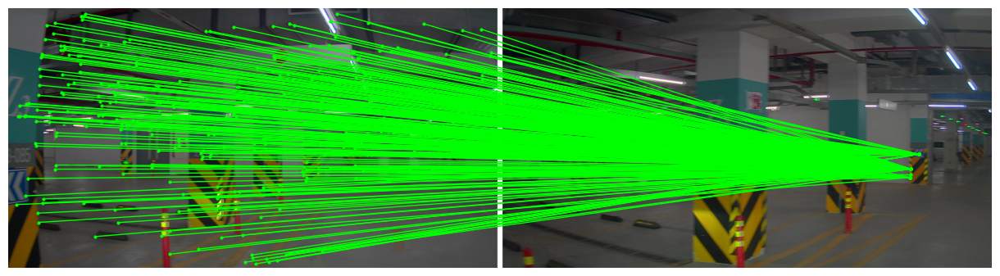

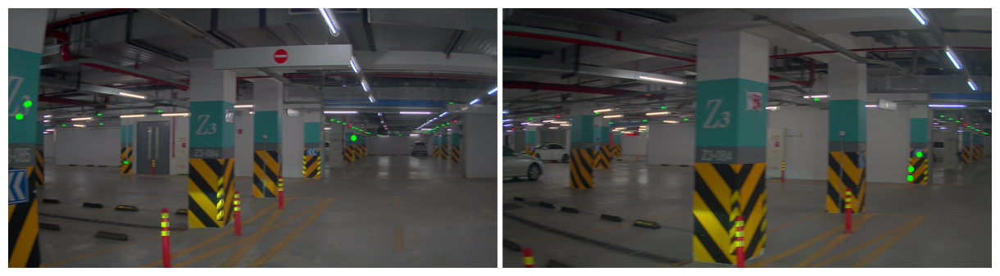

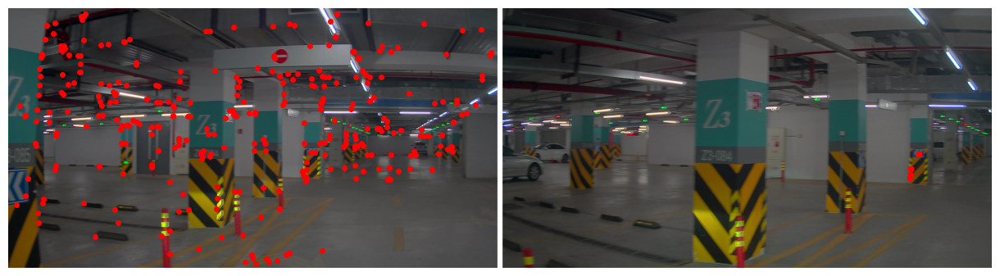

In [6]:
config_pose = {
    'reproj_error': 10,
    'min_inliers': 12,
}
config = {'global': config_global, 'local': config_local, 'pose': config_pose}
loc = Localization('aachen', model, config)
queries = read_query_list(Path(loc.base_path, 'cam03.txt'))

# q_name=['query/1606405707.70533782.png','query/1606405614.20798524.png']
q_name=['query/1606405726.20872613.png']
# query_dataset = Aachen(**{'resize_max': 1920,
#                           'image_names': q_name})
query_dataset = Aachen(**{'resize_max': 1920,
                          'image_names': [q.name for q in queries]})

def get_image(name):
    path = Path(DATA_PATH, query_dataset.dataset_folder,name)
    return cv2.imread(path.as_posix())[..., ::-1]
def get_image2(name):
    path = Path(DATA_PATH, query_dataset.dataset_folder,'db',name)
    return cv2.imread(path.as_posix())[..., ::-1]

query_iter = query_dataset.get_test_set()
for i, query_info, query_data in zip(range(0,len(queries)), queries, query_iter):
    if query_info.name in q_name: 
        
        results, debug = loc.localize(query_info, query_data, debug=True)

        s = f'{i} {"Success" if results.success else "Failure"}, inliers {results.num_inliers:^4}, ' \
            + f'ratio {results.inlier_ratio:.3f}, landmarks {len(debug["matching"]["lm_frames"]):>4}, ' \
            + f'spl {debug["index_success"]:>2}, places {[len(p) for p in debug["places"]]:}, ' \
            + f'pos {[f"{n:.1f}" for n in results.T[:3, 3]]}'
        print(s)
        query_T_w = np.linalg.inv(results.T)
        qvec_nvm = list(Quaternion(matrix=query_T_w))
        pos_nvm = query_T_w[:3, 3].tolist()
        print("QUERT IMAGE---"+query_info.name)
        path_query=Path(DATA_PATH,'aachen/image',query_info.name)
        display(Image.open(path_query).resize((960,510)))

        p=reduce(operator.add, debug["places"])
        print("TOP K ")
        print(p)
        for k in range(0,len(p)):
            p[k]=loc.images[p[k]].name
        print(p)


        for pname in p:
            path_topk=Path(DATA_PATH, 'aachen/image/db',pname)
            display(Image.open(path_topk).resize((480,260)))
            print(pname)

        sorted_frames, counts = np.unique(
            [debug['matching']['lm_frames'][m2] for m1, m2 in debug['matches'][debug['inliers']]],
            return_counts=True)

        best_id = sorted_frames[np.argmax(counts)]


        query_image = get_image(query_info.name)

        best_image = get_image2(loc.images[best_id].name)


        print("FINAL_IMAGE:"+loc.images[best_id].name)
        path_final=Path(DATA_PATH,'aachen/image/db',loc.images[best_id].name)
        display(Image.open(path_final).resize((960,510)))

        best_matches_inliers = [(m1, debug['matching']['lm_indices'][m2]) 
                                for m1, m2 in debug['matches'][debug['inliers']] 
                                if debug['matching']['lm_frames'][m2] == best_id]
        print("inliers:"+len(best_matches_inliers).__str__())

        best_matches_outliers = [(m1, debug['matching']['lm_indices'][m2])
                                for i, (m1, m2) in enumerate(debug['matches']) 
                                if debug['matching']['lm_frames'][m2] == best_id
                                and i not in debug['inliers']]
        print("outliers:"+len(best_matches_outliers).__str__())
        all_matches=best_matches_inliers+best_matches_outliers
        print(len(all_matches))

        plot_matches(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            np.array(best_matches_inliers), color=(0, 1., 0),
            dpi=100, ylabel=str(i), thickness=1.)
        
        plot_matches(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            np.array(best_matches_outliers), color=(1., 0, 0),       
            dpi=100, ylabel=str(i), thickness=1.)
        plot_matches(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            np.array(all_matches), color=(0, 1., 0),       
            dpi=100, ylabel=str(i), thickness=1.)
        plot_keypoints(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            np.array(best_matches_inliers), color=(0, 1., 0),
            dpi=100, ylabel=str(i), thickness=1.)
        plot_keypoints(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            #np.array(best_matches_inliers), color=(0, 1., 0),
            np.array(best_matches_outliers), color=(1., 0, 0),       
            dpi=100, ylabel=str(i), thickness=1.)
        print(qvec_nvm,pos_nvm)


[01/19/2021 17:45:23 INFO] Importing COLMAP model cam03_model
/home/autolab/anaconda3/envs/cyf/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/autolab/anaconda3/envs/cyf/lib/python3.6/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
[01/19/2021 17:45:31 INFO] Number of images: 7303
Number of points: 293536
Median keypoints per image: 1817.0
Ratio of matched keypoints: 0.148

[01/19/2021 17:45:31 INFO] Importing global and local databases
[01/19/2021 17:45:41 INFO] Indexing descriptors


this is fastmatcher
439 Success, inliers 286 , ratio 0.297, landmarks 8545, spl  0, places [10], pos ['-26.1', '116.0', '-3.6']
QUERT IMAGE---query/1606405614.20798524.png


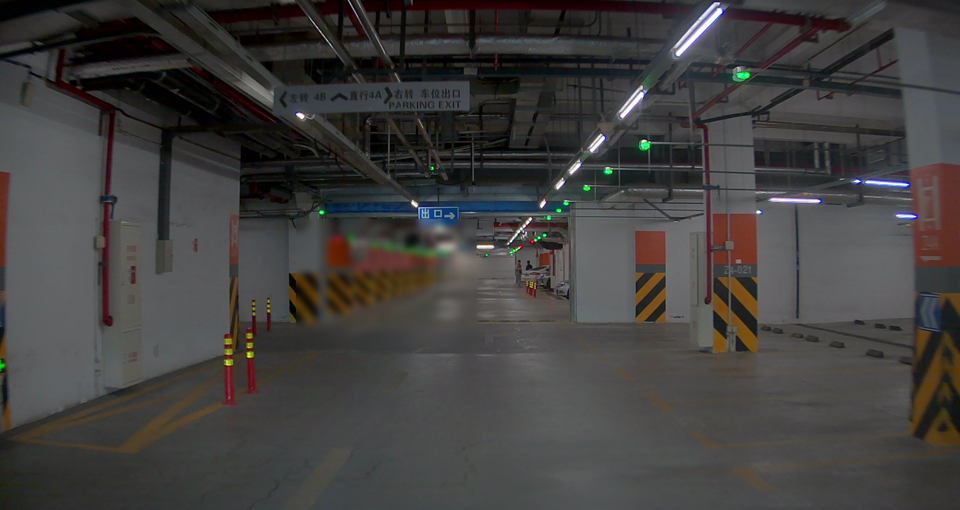

TOP K 
[5350, 5351, 5352, 5354, 5343, 5344, 5346, 5347, 5348, 5349]
['1606404739.20466142.png', '1606404739.30379724.png', '1606404739.40419324.png', '1606404739.60776311.png', '1606404738.50807228.png', '1606404738.60479143.png', '1606404738.80672886.png', '1606404738.90811470.png', '1606404739.00545825.png', '1606404739.10711301.png']


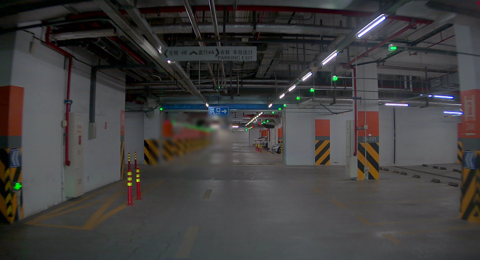

1606404739.20466142.png


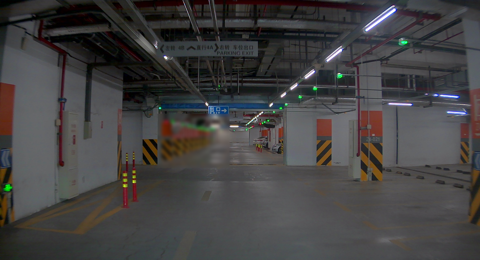

1606404739.30379724.png


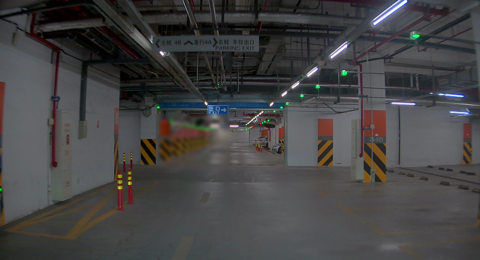

1606404739.40419324.png


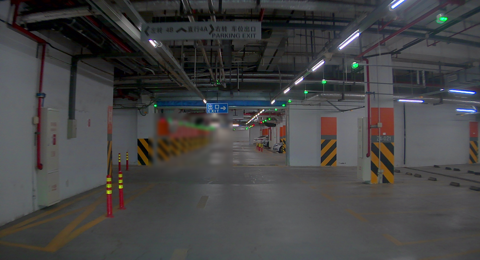

1606404739.60776311.png


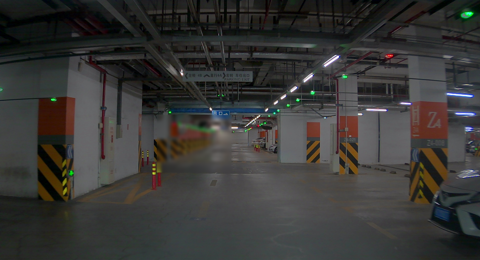

1606404738.50807228.png


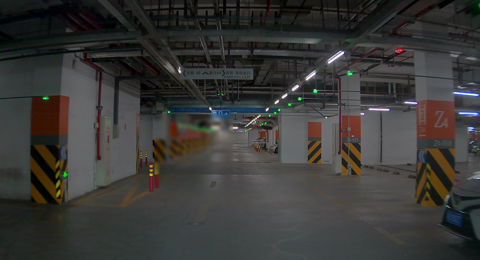

1606404738.60479143.png


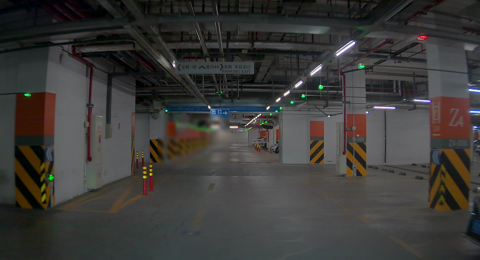

1606404738.80672886.png


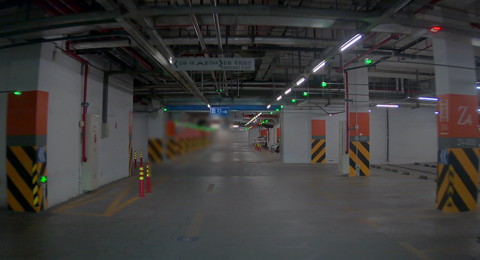

1606404738.90811470.png


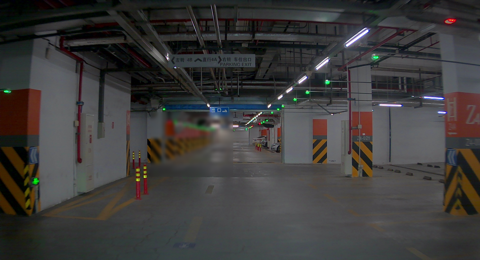

1606404739.00545825.png


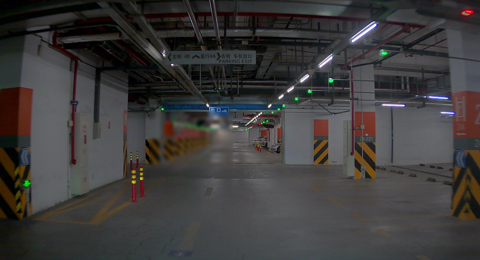

1606404739.10711301.png
FINAL_IMAGE:1606404739.60776311.png


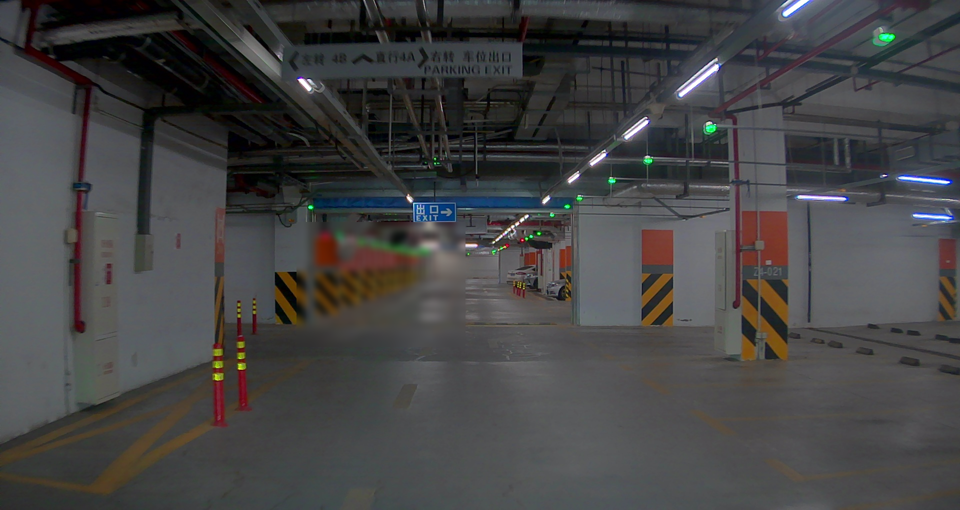

inliers:51
outliers:58
109
[0.5020663972844628, 0.49643989148823564, -0.4985623978681549, 0.502903869828921] [115.87676131660642, -3.5340729429233715, 26.5255605088394]
this is fastmatcher
510 Success, inliers  62 , ratio 0.079, landmarks 1409, spl  0, places [10], pos ['-67.4', '100.6', '-3.5']
QUERT IMAGE---query/1606405707.70533782.png


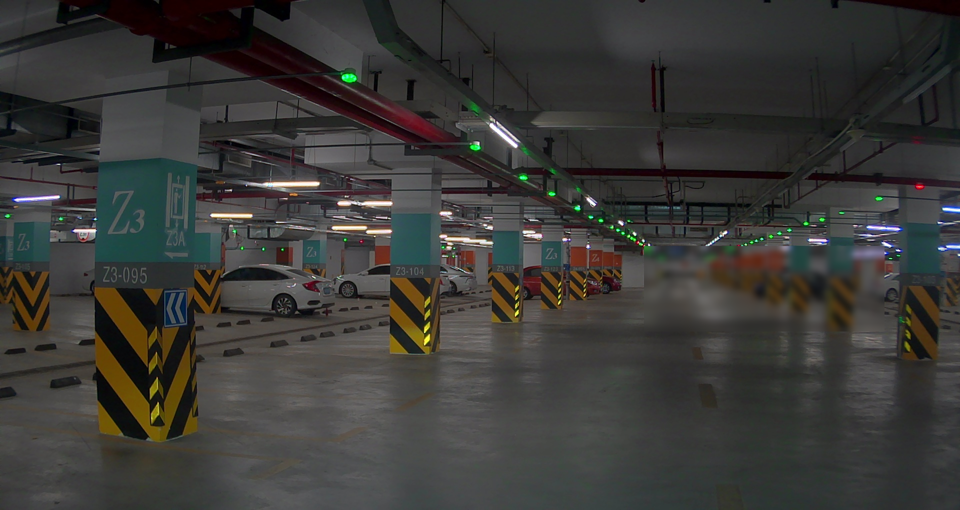

TOP K 
[6273, 6275, 6279, 6230, 6265, 6268, 6270, 6271, 6241, 6242]
['1606404831.50435764.png', '1606404831.70823481.png', '1606404832.10827997.png', '1606404827.20829504.png', '1606404830.76792761.png', '1606404831.00711296.png', '1606404831.20794042.png', '1606404831.30753516.png', '1606404828.30375782.png', '1606404828.40400208.png']


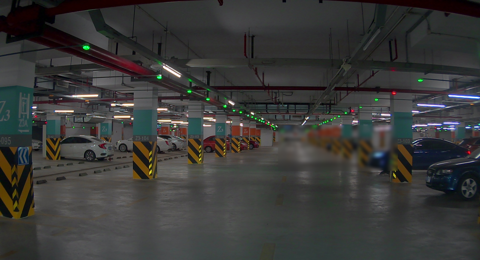

1606404831.50435764.png


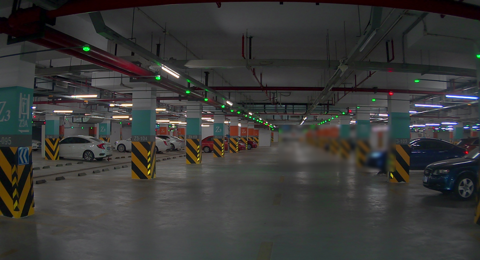

1606404831.70823481.png


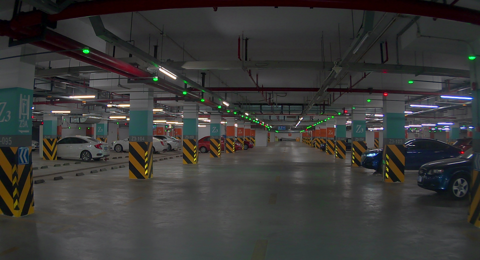

1606404832.10827997.png


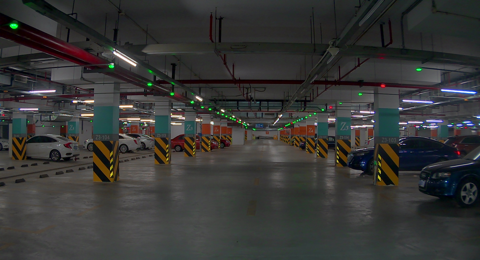

1606404827.20829504.png


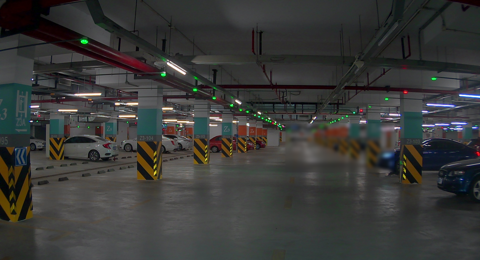

1606404830.76792761.png


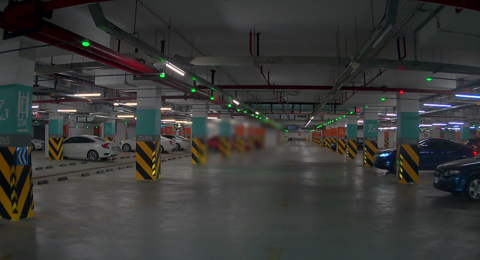

1606404831.00711296.png


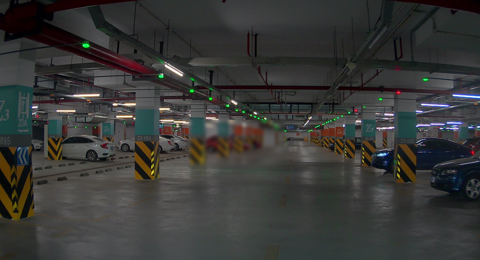

1606404831.20794042.png


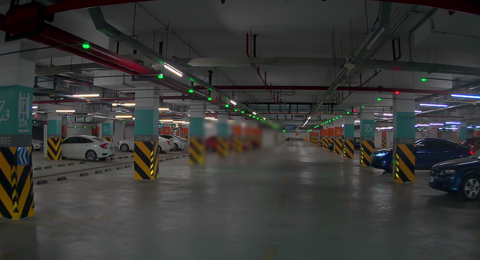

1606404831.30753516.png


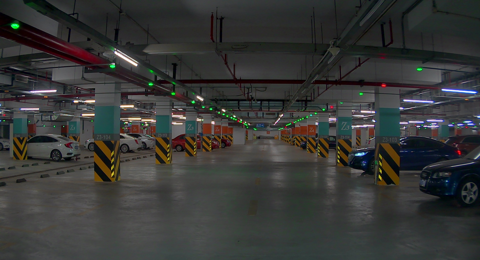

1606404828.30375782.png


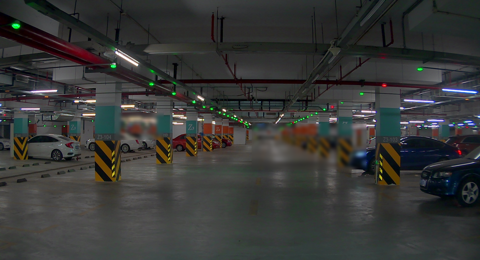

1606404828.40400208.png
FINAL_IMAGE:1606404827.20829504.png


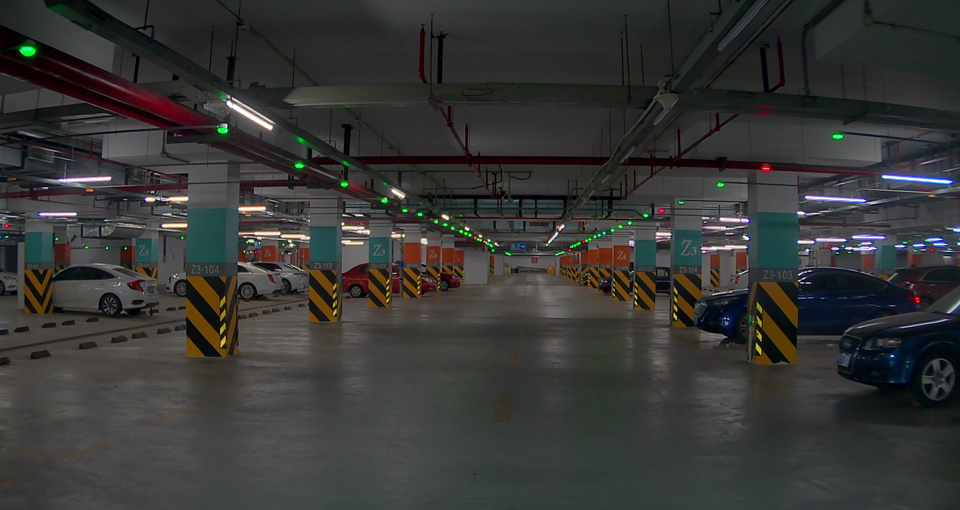

inliers:18
outliers:159
177
[0.5344651602780036, 0.5449261001151338, -0.44814909001415165, 0.4653653736386141] [110.35504753190719, -0.13605082996901083, 49.82472607267562]
this is fastmatcher
this is fastmatcher
this is fastmatcher
this is fastmatcher
524 Failure, inliers  4  , ratio 0.009, landmarks    6, spl -1, places [2, 2, 2, 1, 1, 1, 1], pos ['-74.4', '95.6', '-3.5']
QUERT IMAGE---query/1606405726.20872613.png


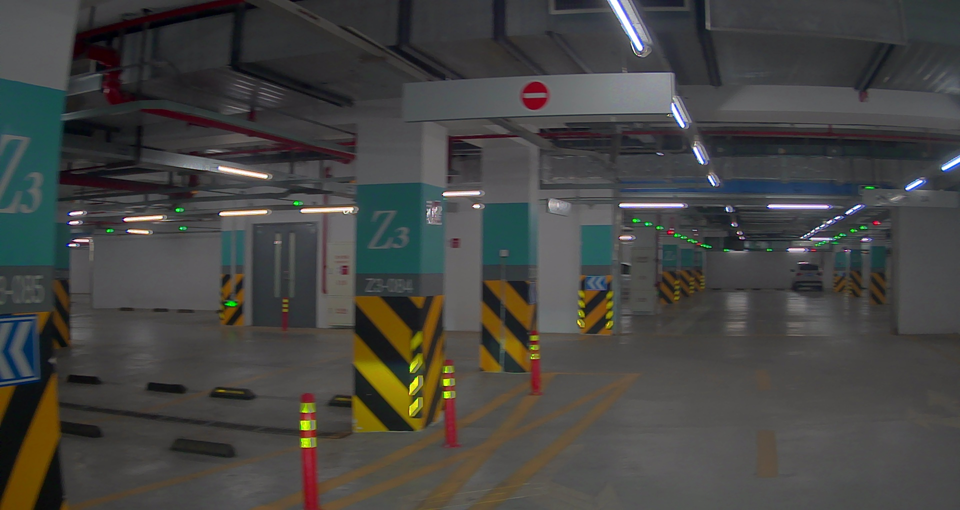

TOP K 
[6473, 6474, 6480, 6477, 6467, 6468, 6481, 6478, 6475, 6469]
['1606404851.50735493.png', '1606404851.60552350.png', '1606404852.20808371.png', '1606404851.97005064.png', '1606404850.90697809.png', '1606404851.00648074.png', '1606404852.30673935.png', '1606404852.06464422.png', '1606404851.70639300.png', '1606404851.10762760.png']


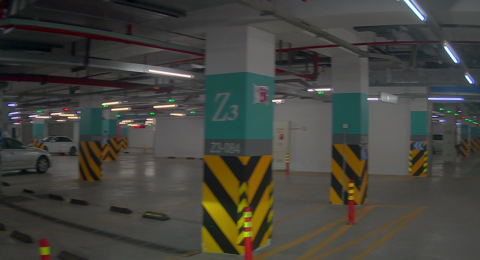

1606404851.50735493.png


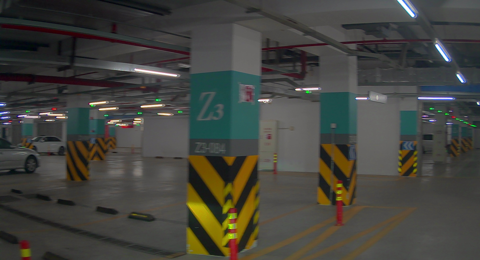

1606404851.60552350.png


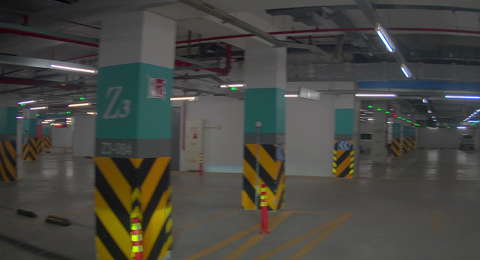

1606404852.20808371.png


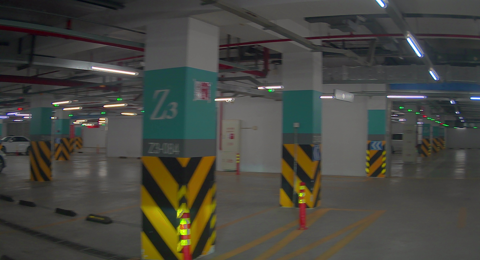

1606404851.97005064.png


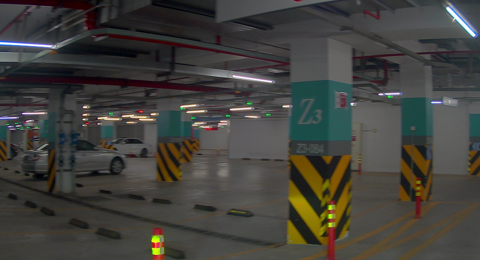

1606404850.90697809.png


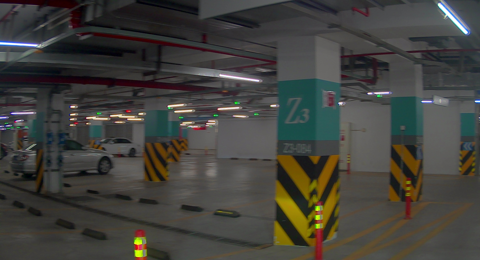

1606404851.00648074.png


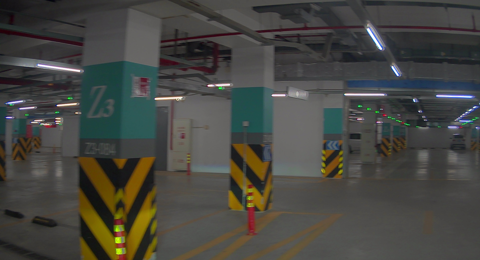

1606404852.30673935.png


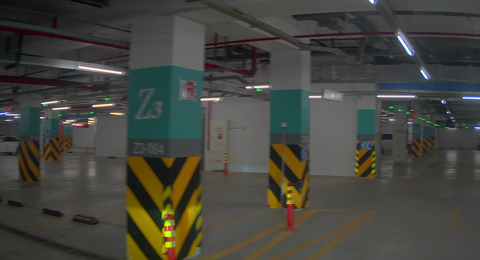

1606404852.06464422.png


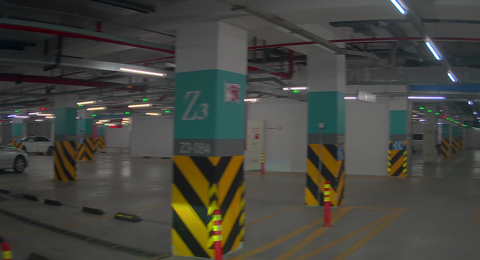

1606404851.70639300.png


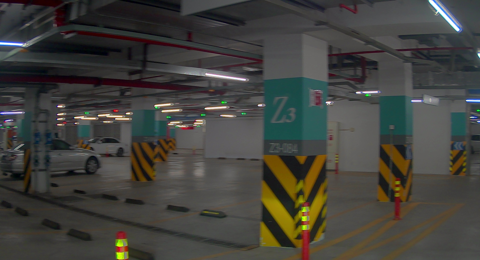

1606404851.10762760.png
FINAL_IMAGE:1606404851.60552350.png


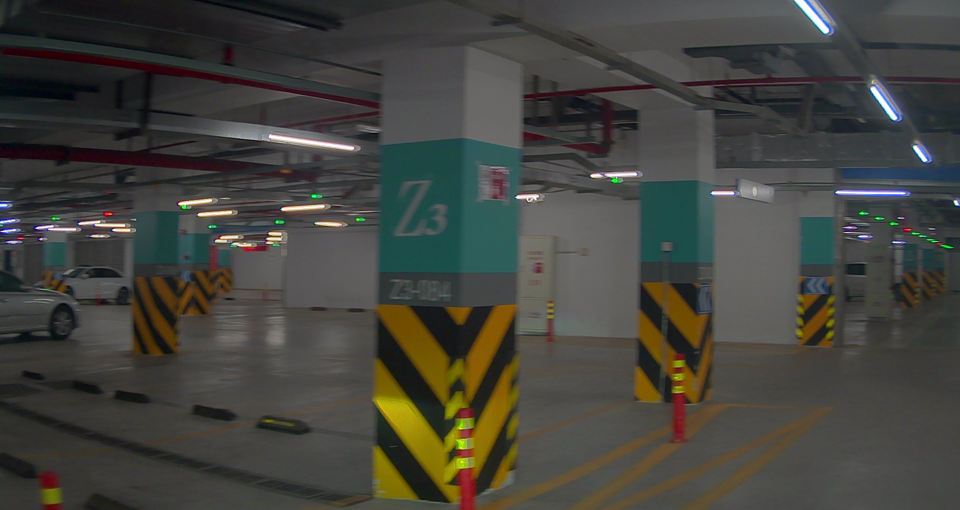

inliers:4
outliers:280
284
[0.2055666812446732, 0.20572995123782076, -0.6743721463416403, 0.6787044533258227] [-8.591517311281208, -2.827570712919537, 120.79646506588247]


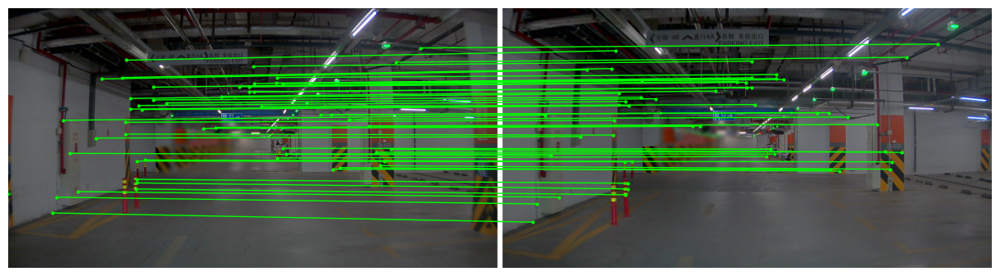

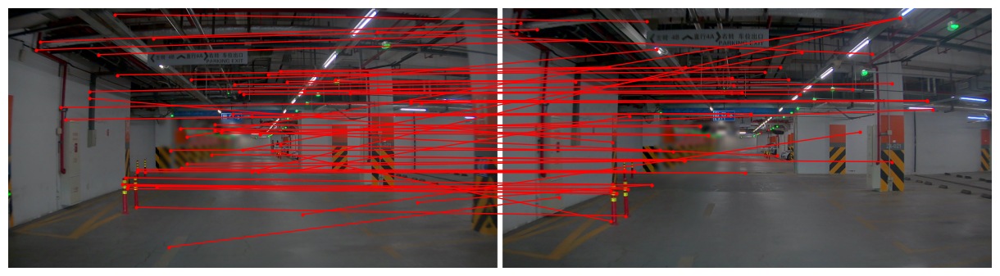

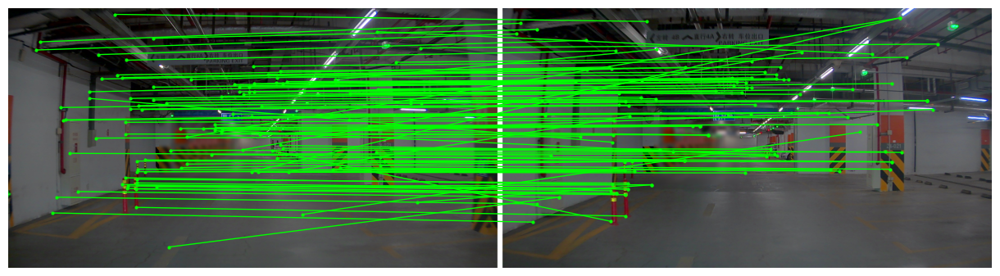

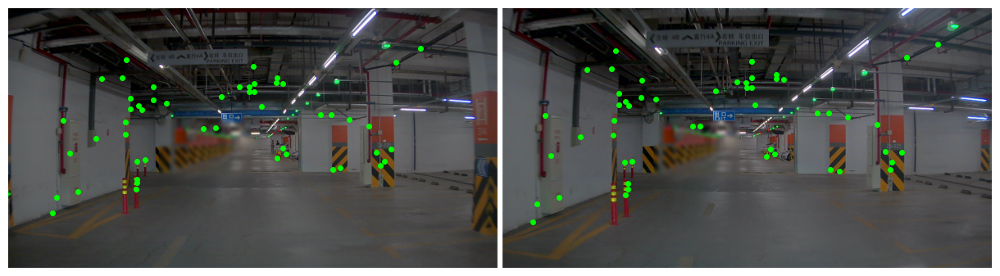

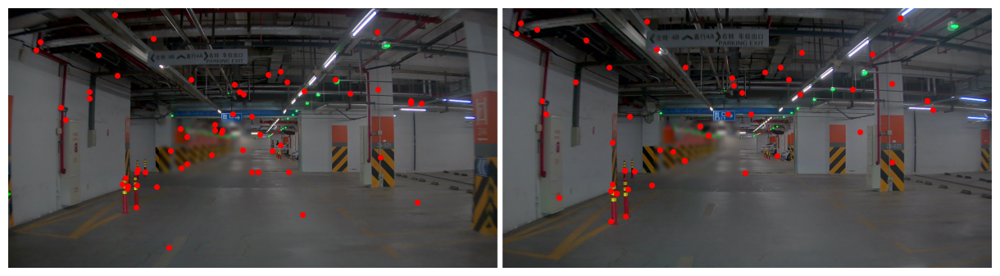

...

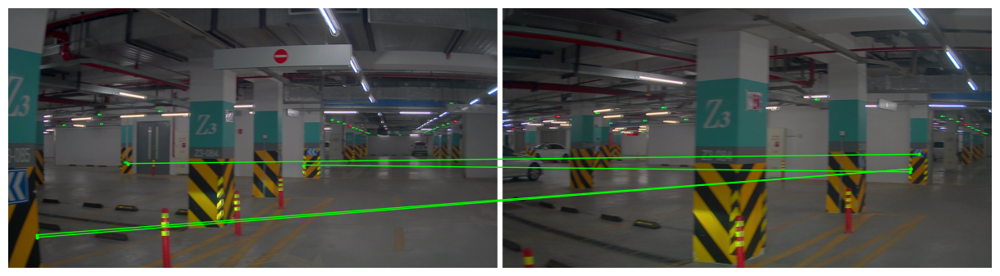

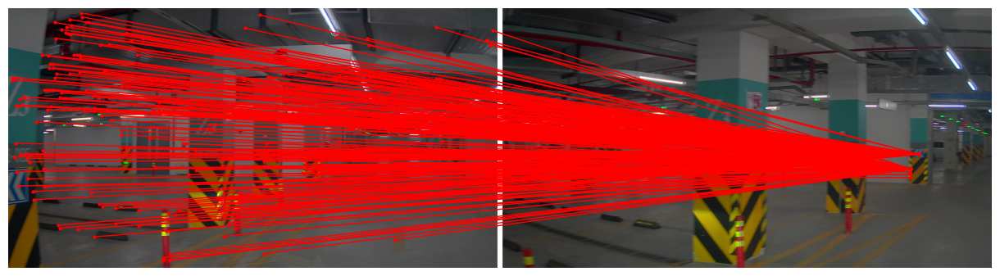

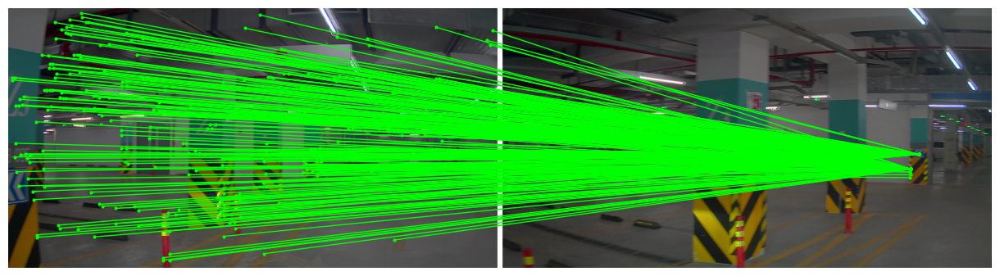

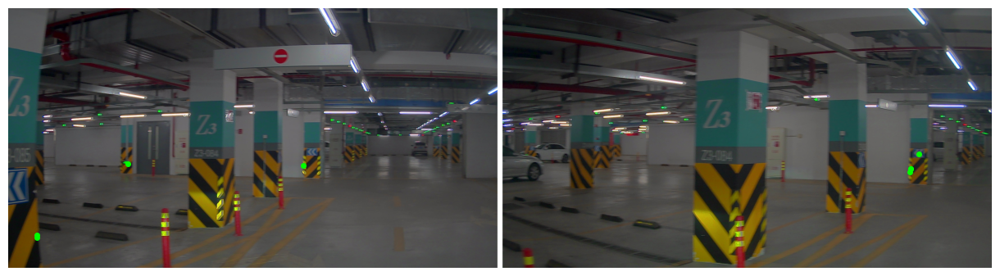

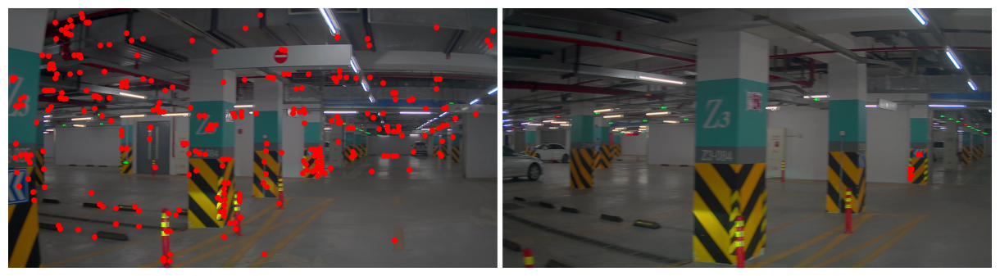

In [8]:
config_local = {
        'db_name': 'localdb_hfnet_960.pkl',
        'experiment':  'hfnet/aachen',
        'predictor_db': export_loader_db,
        'predictor': export_loader,
        'has_keypoints': True,
        'has_descriptors': True,
        # 'do_nms': True,
        # 'nms_thresh': 4,
        'num_features': 2000,
        'ratio_thresh': 0.9,
    }

config_pose = {
    'reproj_error': 10,
    'min_inliers': 12,
}
config = {'global': config_global, 'local': config_local, 'pose': config_pose}
loc = Localization('aachen', model, config)
queries = read_query_list(Path(loc.base_path, 'cam03.txt'))

q_name=['query/1606405726.20872613.png','query/1606405707.70533782.png','query/1606405614.20798524.png']
# query_dataset = Aachen(**{'resize_max': 1920,
#                           'image_names': q_name})
query_dataset = Aachen(**{'resize_max': 960,
                          'image_names': [q.name for q in queries]})

def get_image(name):
    path = Path(DATA_PATH, query_dataset.dataset_folder,name)
    return cv2.imread(path.as_posix())[..., ::-1]
def get_image2(name):
    path = Path(DATA_PATH, query_dataset.dataset_folder,'db',name)
    return cv2.imread(path.as_posix())[..., ::-1]

query_iter = query_dataset.get_test_set()
for i, query_info, query_data in zip(range(0,len(queries)), queries, query_iter):
    if query_info.name in q_name: 
        
        results, debug = loc.localize(query_info, query_data, debug=True)

        s = f'{i} {"Success" if results.success else "Failure"}, inliers {results.num_inliers:^4}, ' \
            + f'ratio {results.inlier_ratio:.3f}, landmarks {len(debug["matching"]["lm_frames"]):>4}, ' \
            + f'spl {debug["index_success"]:>2}, places {[len(p) for p in debug["places"]]:}, ' \
            + f'pos {[f"{n:.1f}" for n in results.T[:3, 3]]}'
        print(s)
        query_T_w = np.linalg.inv(results.T)
        qvec_nvm = list(Quaternion(matrix=query_T_w))
        pos_nvm = query_T_w[:3, 3].tolist()
        print("QUERT IMAGE---"+query_info.name)
        path_query=Path(DATA_PATH,'aachen/image',query_info.name)
        display(Image.open(path_query).resize((960,510)))

        p=reduce(operator.add, debug["places"])
        print("TOP K ")
        print(p)
        for k in range(0,len(p)):
            p[k]=loc.images[p[k]].name
        print(p)


        for pname in p:
            path_topk=Path(DATA_PATH, 'aachen/image/db',pname)
            display(Image.open(path_topk).resize((480,260)))
            print(pname)

        sorted_frames, counts = np.unique(
            [debug['matching']['lm_frames'][m2] for m1, m2 in debug['matches'][debug['inliers']]],
            return_counts=True)

        best_id = sorted_frames[np.argmax(counts)]


        query_image = get_image(query_info.name)

        best_image = get_image2(loc.images[best_id].name)


        print("FINAL_IMAGE:"+loc.images[best_id].name)
        path_final=Path(DATA_PATH,'aachen/image/db',loc.images[best_id].name)
        display(Image.open(path_final).resize((960,510)))

        best_matches_inliers = [(m1, debug['matching']['lm_indices'][m2]) 
                                for m1, m2 in debug['matches'][debug['inliers']] 
                                if debug['matching']['lm_frames'][m2] == best_id]
        print("inliers:"+len(best_matches_inliers).__str__())

        best_matches_outliers = [(m1, debug['matching']['lm_indices'][m2])
                                for i, (m1, m2) in enumerate(debug['matches']) 
                                if debug['matching']['lm_frames'][m2] == best_id
                                and i not in debug['inliers']]
        print("outliers:"+len(best_matches_outliers).__str__())
        all_matches=best_matches_inliers+best_matches_outliers
        print(len(all_matches))

        plot_matches(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            np.array(best_matches_inliers), color=(0, 1., 0),
            dpi=100, ylabel=str(i), thickness=1.)
        
        plot_matches(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            np.array(best_matches_outliers), color=(1., 0, 0),       
            dpi=100, ylabel=str(i), thickness=1.)
        plot_matches(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            np.array(all_matches), color=(0, 1., 0),       
            dpi=100, ylabel=str(i), thickness=1.)
        plot_keypoints(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            np.array(best_matches_inliers), color=(0, 1., 0),
            dpi=100, ylabel=str(i), thickness=1.)
        plot_keypoints(
            query_image, debug['query_item'].keypoints,
            best_image, loc.local_db[best_id].keypoints,
            #np.array(best_matches_inliers), color=(0, 1., 0),
            np.array(best_matches_outliers), color=(1., 0, 0),       
            dpi=100, ylabel=str(i), thickness=1.)
        print(qvec_nvm,pos_nvm)
